In [97]:
import numpy as np
import pandas as pd
import plotly.graph_objects as go
import polars as pl
import seaborn as sns
from ipywidgets import widgets

In [129]:
uniprot_sprot = pd.read_parquet("uniprot_sprot_taxonomy_summary.parquet")
print(uniprot_sprot.shape)


def merge_microbes(species_type):
    if species_type in {"Bacteria", "Archaea", "Viruses"}:
        return "Microbial"
    else:
        return species_type.title()


def assign_superdomain(species_type):
    if species_type == "Viruses":
        return "Non-cellular Life"
    else:
        return "Cellular Life"


def assign_domain(species_type):
    if species_type in {"Bacteria", "Archaea", "Viruses"}:
        return species_type
    else:
        return "Eukaryota"


def assign_kingdom(species_type):
    if species_type in {"Bacteria", "Archaea"}:
        return "Monera"
    else:
        return species_type


uniprot_sprot["type_merge_microbes"] = uniprot_sprot["type"].apply(merge_microbes)
uniprot_sprot["superdomain"] = uniprot_sprot["type"].apply(assign_superdomain)
uniprot_sprot["domain"] = uniprot_sprot["type"].apply(assign_domain)
uniprot_sprot["kingdom"] = uniprot_sprot["type"].apply(assign_kingdom)
uniprot_sprot.head()

(14755, 7)


,organism,reviewed_count,unreviewed_count,pdb_structures_count,organism_id,lineage,type,type_merge_microbes,superdomain,domain,kingdom
0,Homo sapiens,20417,20417,8511,9606,Catarrhini; Chordata; Craniata; Euarchontoglir...,Animal,Animal,Cellular Life,Eukaryota,Animal
1,Mus musculus,17228,17228,2458,10090,Chordata; Craniata; Euarchontoglires; Eukaryot...,Animal,Animal,Cellular Life,Eukaryota,Animal
2,Arabidopsis thaliana,16396,16396,1057,3702,Arabidopsis; Brassicaceae; Brassicales; Cameli...,Plant,Plant,Cellular Life,Eukaryota,Plant
3,Rattus norvegicus,8209,8209,724,10116,Chordata; Craniata; Euarchontoglires; Eukaryot...,Animal,Animal,Cellular Life,Eukaryota,Animal
4,Saccharomyces cerevisiae (strain ATCC 204508 /...,6733,6733,2114,559292,Ascomycota; Dikarya; Eukaryota; Fungi; Sacchar...,Fungi,Fungi,Cellular Life,Eukaryota,Fungi


In [130]:
uniprot_sprot.groupby(["superdomain", "domain", "kingdom"]).size()

superdomain        domain     kingdom        
Cellular Life      Archaea    Monera              236
                   Bacteria   Monera             3353
                   Eukaryota  Animal             4967
                              Fungi               871
                              Plant              2194
                              other Eukaryota     368
Non-cellular Life  Viruses    Viruses            2766
dtype: int64

In [126]:
# uniprot_sprot.sort_values("n_proteins", ascending=False).head()

In [87]:
uniprot_sprot_summarized_per_organism = uniprot_sprot.groupby("organism").agg(
    {
        "reviewed_count": "sum",
        "organism": "first",
        "organism_id": "first",
        "lineage": "first",
        "type": "first",
        "type_merge_microbes": "first",
        "pdb_structures_count": "sum",
    }
)
print(uniprot_sprot_summarized_per_organism.shape)
uniprot_sprot_summarized_per_organism.sort_values("reviewed_count", ascending=False)

(14755, 7)


,reviewed_count,organism,organism_id,lineage,type,type_merge_microbes,pdb_structures_count
organism,,,,,,,
Homo sapiens,20417,Homo sapiens,9606,Catarrhini; Chordata; Craniata; Euarchontoglir...,Animal,Animal,8511
Mus musculus,17228,Mus musculus,10090,Chordata; Craniata; Euarchontoglires; Eukaryot...,Animal,Animal,2458
Arabidopsis thaliana,16396,Arabidopsis thaliana,3702,Arabidopsis; Brassicaceae; Brassicales; Cameli...,Plant,Plant,1057
Rattus norvegicus,8209,Rattus norvegicus,10116,Chordata; Craniata; Euarchontoglires; Eukaryot...,Animal,Animal,724
Saccharomyces cerevisiae (strain ATCC 204508 / S288c),6733,Saccharomyces cerevisiae (strain ATCC 204508 /...,559292,Ascomycota; Dikarya; Eukaryota; Fungi; Sacchar...,Fungi,Fungi,2114
...,...,...,...,...,...,...,...
Plasmodium falciparum (isolate FCH-5),1,Plasmodium falciparum (isolate FCH-5),132416,Aconoidasida; Alveolata; Apicomplexa; Eukaryot...,other Eukaryota,Other Eukaryota,0
Lilium michiganense,1,Lilium michiganense,84049,Embryophyta; Eukaryota; Liliaceae; Liliales; L...,Plant,Plant,0
Lilium regale,1,Lilium regale,82328,Embryophyta; Eukaryota; Liliaceae; Liliales; L...,Plant,Plant,0


In [64]:
uniprot_sprot_n_proteins_per_organism = (
    uniprot_sprot.groupby("organism").n_proteins.sum().sort_values(ascending=False)
)
uniprot_sprot_n_proteins_per_organism.head(10)

organism
Homo sapiens                                             20417
Mus musculus                                             17228
Arabidopsis thaliana                                     16396
Rattus norvegicus                                         8209
Saccharomyces cerevisiae (strain ATCC 204508 / S288c)     6733
Bos taurus                                                6048
Schizosaccharomyces pombe (strain 972 / ATCC 24843)       5121
Escherichia coli (strain K12)                             4531
Caenorhabditis elegans                                    4489
Bacillus subtilis (strain 168)                            4191
Name: n_proteins, dtype: uint32

In [28]:
uniprot_sprot.type_merge_microbes.value_counts()

type_merge_microbes
Microbial          71778
Animal             19022
Plant               9836
Fungi               6952
Other Eukaryota     2694
Name: count, dtype: int64

In [43]:
uniprot_sprot_n_proteins = uniprot_sprot.groupby("type_merge_microbes").n_proteins.sum()
uniprot_sprot_n_proteins.name = "n_proteins_sprot"
uniprot_sprot_n_proteins

type_merge_microbes
Animal             110164
Fungi               37406
Microbial          373984
Other Eukaryota      9540
Plant               41876
Name: n_proteins_sprot, dtype: uint32

In [32]:
uniprot_n_proteins.sum()

np.uint64(572970)

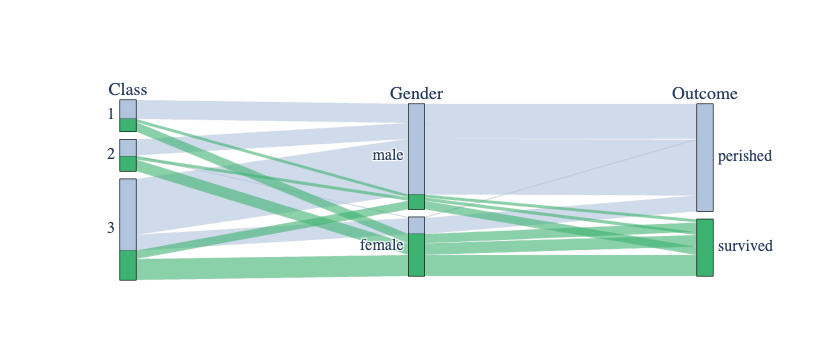

In [6]:
import pandas as pd
import plotly.graph_objects as go

titanic_df = pd.read_csv(
    "https://raw.githubusercontent.com/plotly/datasets/master/titanic.csv"
)

# Create dimensions
class_dim = go.parcats.Dimension(
    values=titanic_df.Pclass, categoryorder="category ascending", label="Class"
)

gender_dim = go.parcats.Dimension(values=titanic_df.Sex, label="Gender")

survival_dim = go.parcats.Dimension(
    values=titanic_df.Survived,
    label="Outcome",
    categoryarray=[0, 1],
    ticktext=["perished", "survived"],
)

# Create parcats trace
color = titanic_df.Survived
colorscale = [[0, "lightsteelblue"], [1, "mediumseagreen"]]

fig = go.Figure(
    data=[
        go.Parcats(
            dimensions=[class_dim, gender_dim, survival_dim],
            line={"color": color, "colorscale": colorscale},
            hoveron="color",
            hoverinfo="count+probability",
            labelfont={"size": 18, "family": "Times"},
            tickfont={"size": 16, "family": "Times"},
            arrangement="freeform",
        )
    ]
)

fig.show()

## Treemap

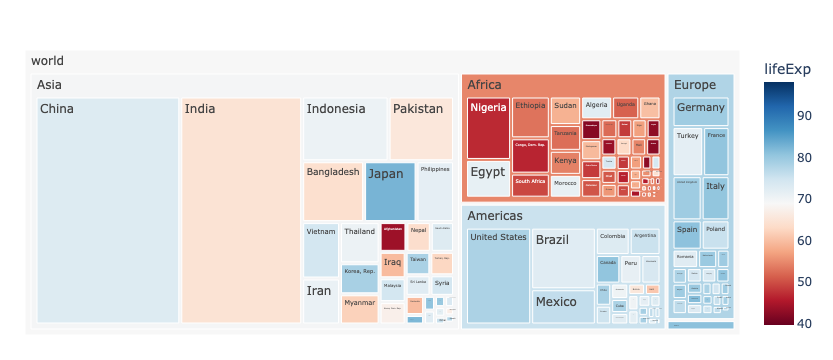

In [7]:
import numpy as np
import plotly.express as px

df = px.data.gapminder().query("year == 2007")
fig = px.treemap(
    df,
    path=[px.Constant("world"), "continent", "country"],
    values="pop",
    color="lifeExp",
    hover_data=["iso_alpha"],
    color_continuous_scale="RdBu",
    color_continuous_midpoint=np.average(df["lifeExp"], weights=df["pop"]),
)
fig.update_layout(margin=dict(t=50, l=25, r=25, b=25))
fig.show()

In [12]:
from io import StringIO

mora_et_al_2011 = pd.read_csv(
    StringIO(
        """Species,Earth_Catalogued,Earth_Predicted,Earth_SE,Ocean_Catalogued,Ocean_Predicted,Ocean_SE
Animalia,953434,7770000,958000,171082,2150000,145000
Chromista,13033,27500,30500,4859,7400,9640
Fungi,43271,611000,297000,1097,5320,11100
Plantae,215644,298000,8200,8600,16600,9130
Protozoa,8118,36400,6690,8118,36400,6690
Eukaryotes_Total,1233500,8740000,1300000,193756,2210000,182000
Archaea,502,455,160,1,1,0
Bacteria,10358,9680,3470,652,1320,436
Prokaryotes_Total,10860,10100,3630,653,1320,436
Grand_Total,1244360,8750000,1300000,194409,2210000,182000"""
    ),
    # index_col=0,
)
mora_et_al_2011

,Species,Earth_Catalogued,Earth_Predicted,Earth_SE,Ocean_Catalogued,Ocean_Predicted,Ocean_SE
0,Animalia,953434,7770000,958000,171082,2150000,145000
1,Chromista,13033,27500,30500,4859,7400,9640
2,Fungi,43271,611000,297000,1097,5320,11100
3,Plantae,215644,298000,8200,8600,16600,9130
4,Protozoa,8118,36400,6690,8118,36400,6690
5,Eukaryotes_Total,1233500,8740000,1300000,193756,2210000,182000
6,Archaea,502,455,160,1,1,0
7,Bacteria,10358,9680,3470,652,1320,436
8,Prokaryotes_Total,10860,10100,3630,653,1320,436
9,Grand_Total,1244360,8750000,1300000,194409,2210000,182000


In [15]:
def merge_mora_eukaryotes(x):
    if x in {"Animalia", "Fungi", "Plantae"}:
        if x == "Animalia":
            return "Animal"
        elif x == "Plantae":
            return "Plant"
        else:
            return x
    elif x in {"Chromista", "Protozoa"}:
        return "Other Eukaryota"


mora_et_al_2011["eukaryote_species"] = mora_et_al_2011["Species"].map(
    merge_mora_eukaryotes
)
mora_et_al_2011

,Species,Earth_Catalogued,Earth_Predicted,Earth_SE,Ocean_Catalogued,Ocean_Predicted,Ocean_SE,eukaryote_species
0,Animalia,953434,7770000,958000,171082,2150000,145000,Animal
1,Chromista,13033,27500,30500,4859,7400,9640,Other Eukaryota
2,Fungi,43271,611000,297000,1097,5320,11100,Fungi
3,Plantae,215644,298000,8200,8600,16600,9130,Plant
4,Protozoa,8118,36400,6690,8118,36400,6690,Other Eukaryota
5,Eukaryotes_Total,1233500,8740000,1300000,193756,2210000,182000,None
6,Archaea,502,455,160,1,1,0,None
7,Bacteria,10358,9680,3470,652,1320,436,None
8,Prokaryotes_Total,10860,10100,3630,653,1320,436,None
9,Grand_Total,1244360,8750000,1300000,194409,2210000,182000,None


In [44]:
earth_predicted_eukaryotes = mora_et_al_2011.groupby("eukaryote_species")[
    "Earth_Predicted"
].sum()
earth_predicted_eukaryotes

eukaryote_species
Animal             7770000
Fungi               611000
Other Eukaryota      63900
Plant               298000
Name: Earth_Predicted, dtype: int64

In [45]:
ocean_predicted_eukaryotes = mora_et_al_2011.groupby("eukaryote_species")[
    "Ocean_Predicted"
].sum()
ocean_predicted_eukaryotes

eukaryote_species
Animal             2150000
Fungi                 5320
Other Eukaryota      43800
Plant                16600
Name: Ocean_Predicted, dtype: int64

In [46]:
earth_catalogued_eukaryotes = mora_et_al_2011.groupby("eukaryote_species")[
    "Earth_Predicted"
].sum()
earth_catalogued_eukaryotes

eukaryote_species
Animal             7770000
Fungi               611000
Other Eukaryota      63900
Plant               298000
Name: Earth_Predicted, dtype: int64

In [47]:
ocean_catalogued_eukaryotes = mora_et_al_2011.groupby("eukaryote_species")[
    "Ocean_Catalogued"
].sum()
ocean_catalogued_eukaryotes

eukaryote_species
Animal             171082
Fungi                1097
Other Eukaryota     12977
Plant                8600
Name: Ocean_Catalogued, dtype: int64

## Add earth plus ocean for predicted

In [48]:
planet_predicted_eukaryotes = earth_predicted_eukaryotes + ocean_predicted_eukaryotes
planet_predicted_eukaryotes.name = "n_species"
# Add 1 billion microbes
planet_predicted_eukaryotes["Microbial"] = 1e9
planet_predicted_eukaryotes

eukaryote_species
Animal             9.920000e+06
Fungi              6.163200e+05
Other Eukaryota    1.077000e+05
Plant              3.146000e+05
Microbial          1.000000e+09
Name: n_species, dtype: float64

## Combine uniprot n proteins vs number of species

In [90]:
n_proteins_vs_n_species = pd.concat(
    [planet_predicted_eukaryotes, uniprot_sprot_n_proteins], axis=1
)


def assign_kingdom(x):
    if x == "Microbial":
        return "Microbes (Bacterial/Archeal/Viral)"
    else:
        return "Eukaryota"


n_proteins_vs_n_species["kingdom"] = n_proteins_vs_n_species.index.map(assign_kingdom)
n_proteins_vs_n_species = n_proteins_vs_n_species.reset_index()
n_proteins_vs_n_species = n_proteins_vs_n_species.rename(
    columns={"index": "organism_type"}
)

# Prediction of number of proteins per gene
n_proteins_multiplier = {
    "Microbial": 5000,
    # "Typical" bacterial genome is 5000 genes: https://pmc.ncbi.nlm.nih.gov/articles/PMC4361730/
    "Bacteria": 5000,
    # Using same number from bacteria for simplicity
    "Archea": 5000,
    # Animal predicted ~20,000 from personal intiution: Humans have 20k, Mouse have ~15k, and bivalves like oysters have 30k
    # Also, this 2013 paper: https://pmc.ncbi.nlm.nih.gov/articles/PMC3737309/
    "Animal": 20000,
    # Fungal predicted ~ 11,000 genes/genome from https://pmc.ncbi.nlm.nih.gov/articles/PMC6078396/
    "Fungi": 11000,
    "Other Eukaryota": 10000,
    # Plant average of 32,000 genes/genome from https://academic.oup.com/bfg/article/13/4/308/2845968?login=false
    "Plant": 32000,
}


def get_n_predicted_proteins(row, n_proteins_multiplier=n_proteins_multiplier):
    multiplier = n_proteins_multiplier[row.organism_type]
    return multiplier * row.n_species


n_proteins_vs_n_species["n_proteins_predicted"] = n_proteins_vs_n_species.apply(
    get_n_predicted_proteins, axis=1
)
n_proteins_vs_n_species

,organism_type,n_species,n_proteins_sprot,kingdom,n_proteins_predicted
0,Animal,9.920000e+06,110164,Eukaryota,1.984000e+11
1,Fungi,6.163200e+05,37406,Eukaryota,6.779520e+09
2,Other Eukaryota,1.077000e+05,9540,Eukaryota,1.077000e+09
3,Plant,3.146000e+05,41876,Eukaryota,1.006720e+10
4,Microbial,1.000000e+09,373984,Microbes (Bacterial/Archeal/Viral),5.000000e+12


In [53]:
df.head()

,country,continent,year,lifeExp,pop,gdpPercap,iso_alpha,iso_num
11,Afghanistan,Asia,2007,43.828,31889923,974.580338,AFG,4
23,Albania,Europe,2007,76.423,3600523,5937.029526,ALB,8
35,Algeria,Africa,2007,72.301,33333216,6223.367465,DZA,12
47,Angola,Africa,2007,42.731,12420476,4797.231267,AGO,24
59,Argentina,Americas,2007,75.320,40301927,12779.379640,ARG,32


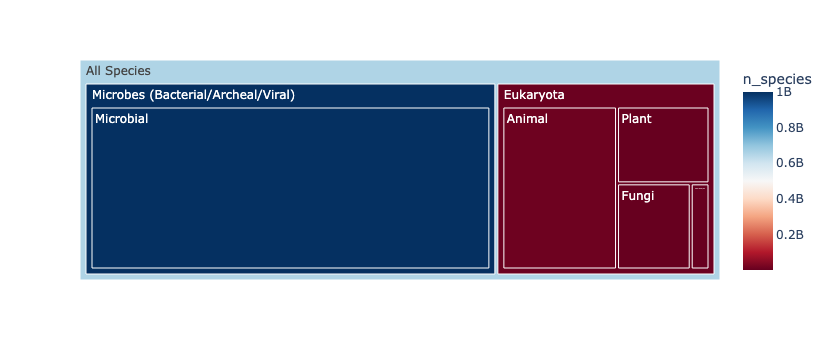

In [68]:
values = "n_proteins_sprot"
color = "n_species"

fig = px.treemap(
    n_proteins_vs_n_species,
    path=[px.Constant("All Species"), "kingdom", "organism_type"],
    values=values,
    color=color,
    hover_data=["organism_type"],
    color_continuous_scale="RdBu",
    # color_continuous_midpoint=np.average(
    #     n_proteins_vs_n_species[color], weights=n_proteins_vs_n_species[values]
    # ),
)
fig.show()

# Try packcircles

## Test that their example works

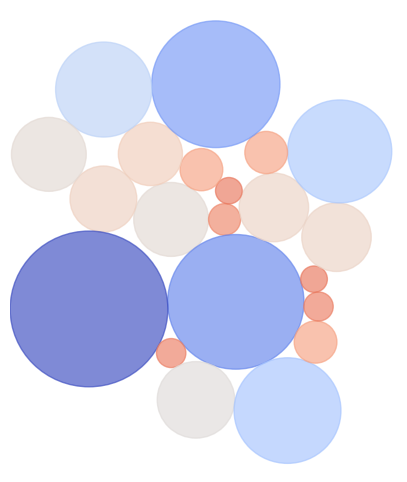

In [72]:
import matplotlib.pyplot as plt
import packcircles as pc
from matplotlib import colormaps

radii = [
    28,
    12,
    51,
    26,
    10,
    16,
    24,
    25,
    59,
    11,
    29,
    40,
    16,
    11,
    10,
    26,
    39,
    16,
    48,
    36,
    28,
]
fig, ax = plt.subplots()
cmap = colormaps["coolwarm_r"]
circles = pc.pack(radii)
for x, y, radius in circles:
    patch = plt.Circle((x, y), radius, color=cmap(radius / max(radii)), alpha=0.65)
    ax.add_patch(patch)
fig.set_figheight(6)
fig.set_figwidth(5)
ax.set(xlim=(-150, 140), ylim=(-180, 170))
plt.axis("off")
plt.show()

## Compute radii using the number of proteins as the area

In [95]:
def get_radii_from_area(area):
    return np.sqrt(area / np.pi)


n_protein_cols = [
    x for x in n_proteins_vs_n_species.columns if x.startswith("n_proteins")
]
n_protein_cols

ModuleNotFoundError: No module named 'seaborn'

In [92]:
for col in n_protein_cols:
    radii_col = f"{col}_radius"
    n_proteins_vs_n_species[radii_col] = n_proteins_vs_n_species[col].map(
        get_radii_from_area
    )
n_proteins_vs_n_species

,organism_type,n_species,n_proteins_sprot,kingdom,n_proteins_predicted,n_proteins_sprot_radius,n_proteins_predicted_radius
0,Animal,9.920000e+06,110164,Eukaryota,1.984000e+11,187.259954,2.513020e+05
1,Fungi,6.163200e+05,37406,Eukaryota,6.779520e+09,109.117824,4.645415e+04
2,Other Eukaryota,1.077000e+05,9540,Eukaryota,1.077000e+09,55.106046,1.851539e+04
3,Plant,3.146000e+05,41876,Eukaryota,1.006720e+10,115.453648,5.660821e+04
4,Microbial,1.000000e+09,373984,Microbes (Bacterial/Archeal/Viral),5.000000e+12,345.025803,1.261566e+06


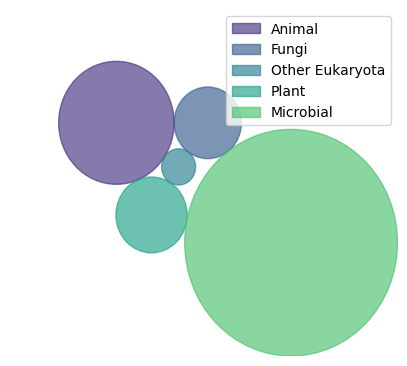

In [123]:
circles = list(pc.pack(n_proteins_vs_n_species["n_proteins_sprot_radius"]))
circles_df = pd.DataFrame(circles, columns=["x", "y", "radius"])
# circles

organism_to_color = dict(
    zip(n_proteins_vs_n_species.organism_type, sns.color_palette("viridis"))
)
organism_to_color

fig, ax = plt.subplots()
for organism_type, (x, y, radius) in zip(
    n_proteins_vs_n_species.organism_type, circles
):
    color = organism_to_color[organism_type]
    patch = plt.Circle((x, y), radius, color=color, alpha=0.65, label=organism_type)
    ax.add_patch(patch)
fig.set_figheight(4.5)
fig.set_figwidth(5)

max_radius = circles_df.radius.max()
xmin = circles_df.x.min() - max_radius
xmax = circles_df.x.max() + max_radius

ymin = circles_df.y.min() - max_radius
ymax = circles_df.y.max() + max_radius

ax.set(xlim=(xmin, xmax), ylim=(ymin, ymax))
ax.legend()
plt.axis("off")
plt.show()

In [115]:
pd.DataFrame(circles, columns=["x", "y", "radius"])

,x,y,radius
0,-191.138005,65.250253,187.259954
1,105.239773,65.250253,109.117824
2,10.651053,-68.997480,55.106046
3,-77.189613,-215.198118,115.453648
4,375.460133,-299.753023,345.025803


In [140]:
int_columns = uniprot_sprot.columns[uniprot_sprot.dtypes == np.uint32]
int_columns

Index(['reviewed_count', 'unreviewed_count', 'pdb_structures_count'], dtype='object')

In [141]:
for col in int_columns:
    radii_col = f"{col}_radius"
    uniprot_sprot[radii_col] = uniprot_sprot[col].map(get_radii_from_area)
uniprot_sprot

,organism,reviewed_count,unreviewed_count,pdb_structures_count,organism_id,lineage,type,type_merge_microbes,superdomain,domain,kingdom,reviewed_count_radius,unreviewed_count_radius,pdb_structures_count_radius
0,Homo sapiens,20417,20417,8511,9606,Catarrhini; Chordata; Craniata; Euarchontoglir...,Animal,Animal,Cellular Life,Eukaryota,Animal,80.615960,80.615960,52.049356
1,Mus musculus,17228,17228,2458,10090,Chordata; Craniata; Euarchontoglires; Eukaryot...,Animal,Animal,Cellular Life,Eukaryota,Animal,74.052972,74.052972,27.971516
2,Arabidopsis thaliana,16396,16396,1057,3702,Arabidopsis; Brassicaceae; Brassicales; Cameli...,Plant,Plant,Cellular Life,Eukaryota,Plant,72.242708,72.242708,18.342670
3,Rattus norvegicus,8209,8209,724,10116,Chordata; Craniata; Euarchontoglires; Eukaryot...,Animal,Animal,Cellular Life,Eukaryota,Animal,51.117569,51.117569,15.180789
4,Saccharomyces cerevisiae (strain ATCC 204508 /...,6733,6733,2114,559292,Ascomycota; Dikarya; Eukaryota; Fungi; Sacchar...,Fungi,Fungi,Cellular Life,Eukaryota,Fungi,46.294497,46.294497,25.940453
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14750,Sitophilus granarius,1,1,0,7046,Arthropoda; Coleoptera; Cucujiformia; Curculio...,Animal,Animal,Cellular Life,Eukaryota,Animal,0.564190,0.564190,0.000000
14751,Cycas panzhihuaensis,1,1,0,123604,Cycadaceae; Cycadales; Cycadidae; Cycas; Embry...,Plant,Plant,Cellular Life,Eukaryota,Plant,0.564190,0.564190,0.000000
14752,Streptococcus phage Cp-7,1,1,1,10748,Caudoviricetes; Cepunavirus; Cepunavirus Cp7; ...,Viruses,Microbial,Non-cellular Life,Viruses,Viruses,0.564190,0.564190,0.564190
14753,Sterkiella cavicola,1,1,0,742176,Alveolata; Ciliophora; Eukaryota; Intramacronu...,other Eukaryota,Other Eukaryota,Cellular Life,Eukaryota,other Eukaryota,0.564190,0.564190,0.000000


In [143]:
def make_color_mapper(column, cmap="viridis"):
    column_unique = sorted(list(set(column)))
    n_colors = len(column_unique)
    color_mapper = dict(
        zip(column_unique, sns.color_palette("viridis", n_colors=n_colors))
    )
    return color_mapper

In [145]:
circles = list(pc.pack(uniprot_sprot["reviewed_count_radius"]))
circles_df = pd.DataFrame(circles, columns=["x", "y", "radius"])
# circles

kingdom_color_mapper = make_color_mapper(uniprot_sprot.kingdom)
kingdom_color_mapper

{'Animal': (0.275191, 0.194905, 0.496005),
 'Fungi': (0.212395, 0.359683, 0.55171),
 'Monera': (0.153364, 0.497, 0.557724),
 'Plant': (0.122312, 0.633153, 0.530398),
 'Viruses': (0.288921, 0.758394, 0.428426),
 'other Eukaryota': (0.626579, 0.854645, 0.223353)}

In [148]:
def plot_circles(df: pd.DataFrame, radius: str, color: str):
    """
    df : pandas.DataFrame


    radius : str
        Name of the column to use for radius
    """
    circles = list(pc.pack(df[radius]))
    circles_df = pd.DataFrame(circles, columns=["x", "y", "radius"])
    # circles

    color_mapper = make_color_mapper(df[color])

    fig, ax = plt.subplots()
    for color_col_value, (i, (x, y, radius)) in zip(df[color], circles_df.iterrows()):
        color = color_mapper[color_col_value]
        patch = plt.Circle(
            (x, y), radius, color=color, alpha=0.65, label=color_col_value
        )
        ax.add_patch(patch)
    fig.set_figheight(4.5)
    fig.set_figwidth(5)

    max_radius = circles_df.radius.max()
    xmin = circles_df.x.min() - max_radius
    xmax = circles_df.x.max() + max_radius

    ymin = circles_df.y.min() - max_radius
    ymax = circles_df.y.max() + max_radius

    ax.set(xlim=(xmin, xmax), ylim=(ymin, ymax))
    ax.legend()
    plt.axis("off")
    plt.show()


plot_circles(uniprot_sprot, "reviewed_count_radius", "kingdom")

/Users/olga/anaconda3/envs/2025-biodata-wealth-inequality/lib/python3.13/site-packages/IPython/core/pylabtools.py:170: UserWarning:

Creating legend with loc="best" can be slow with large amounts of data.

